In [18]:
import pandas as pd
import plotly.express as px
import statsmodels.api as sm
import plotly.graph_objects as go


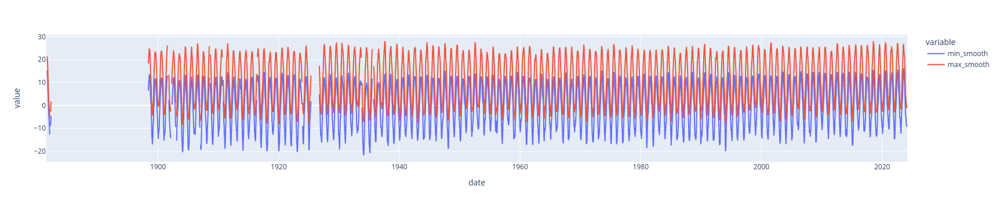

In [7]:
df = pd.read_csv("weatherstats_moncton_daily.csv", low_memory=False)
df.date = pd.to_datetime(df.date)
df['year'] = df.date.dt.year
df['dayofyear']=df.date.dt.dayofyear
df['max_smooth'] = df['max_temperature'].rolling(window=45, center=True).mean()
df['min_smooth'] = df['min_temperature'].rolling(window=45, center=True).mean()
px.line(df, 'date', ['min_smooth', 'max_smooth'])

In [8]:
df.head()

,date,max_temperature,avg_hourly_temperature,avg_temperature,min_temperature,max_humidex,min_windchill,max_relative_humidity,avg_hourly_relative_humidity,avg_relative_humidity,...,avg_cloud_cover_8,min_cloud_cover_8,max_cloud_cover_10,avg_hourly_cloud_cover_10,avg_cloud_cover_10,min_cloud_cover_10,year,dayofyear,max_smooth,min_smooth
0,2024-03-02,9.7,0.60,-0.45,-10.6,NaN,-17.0,88.0,68.8,66.5,...,4.0,0.0,NaN,NaN,NaN,NaN,2024,62,NaN,NaN
1,2024-03-01,-7.4,-11.30,-11.50,-15.6,NaN,-27.0,76.0,59.2,60.0,...,3.5,0.0,NaN,NaN,NaN,NaN,2024,61,NaN,NaN
2,2024-02-29,11.1,-2.62,-1.15,-13.4,NaN,-24.0,99.0,80.3,80.0,...,4.5,1.0,NaN,NaN,NaN,NaN,2024,60,NaN,NaN
3,2024-02-28,10.9,8.47,7.85,4.8,NaN,NaN,98.0,95.7,95.0,...,6.5,5.0,NaN,NaN,NaN,NaN,2024,59,NaN,NaN
4,2024-02-27,8.9,2.06,2.25,-4.4,NaN,-9.0,95.0,75.2,69.0,...,3.5,0.0,NaN,NaN,NaN,NaN,2024,58,NaN,NaN


# Anomalies
Calculate the anomalies by subtracting `max_smooth` from `max_temperature`.
Plot a histogram with marginal distribution

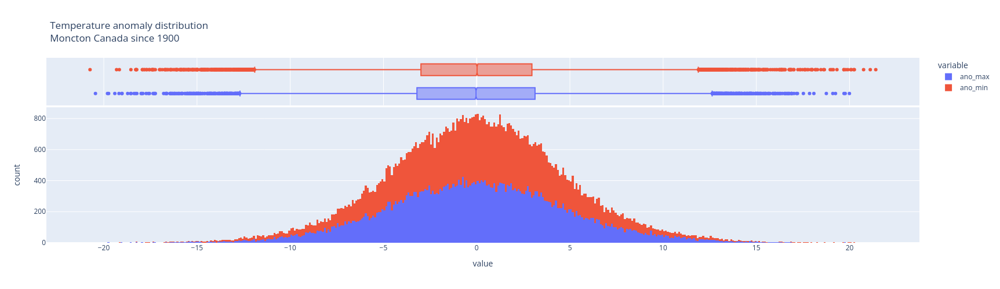

In [3]:
df['ano_max']= df.max_temperature - df.max_smooth
df['ano_min']= df.min_temperature - df.min_smooth
px.histogram(df, x=['ano_max','ano_min'],  marginal='box', 
             hover_data = ['date', 'date'],
             title='Temperature anomaly distribution<br>Moncton Canada since 1900',
            height=500)

# determine trendline
We need to go to julian dates for an Ordinary Least Squares fit.

In [4]:
df['jul1'] = pd.DatetimeIndex(df['date']).to_julian_date()
model = sm.OLS(df['max_smooth'], sm.add_constant(df.jul1), missing='drop')
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:             max_smooth   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     40.49
Date:                Thu, 14 Mar 2024   Prob (F-statistic):           2.00e-10
Time:                        12:59:54   Log-Likelihood:            -1.6757e+05
No. Observations:               45053   AIC:                         3.351e+05
Df Residuals:                   45051   BIC:                         3.352e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -44.1869      8.618     -5.127      0.000     -61.078     -27.295
jul1         2.25e-05   3.54e-06      6.363      0.000    1.56e-05    2.94e-05
==============================================================================
Omnibus:                   400559.043   Durbin-Watson:                   0.001
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             3718.505
Skew:                          -0.033   Prob(JB):                         0.00
Kurtosis:                       1.594   Cond. No.                     4.47e+08
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 4.47e+08. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

# Determine trend
plot the trend line, which ends up at ca. 0.8°C over the last century.

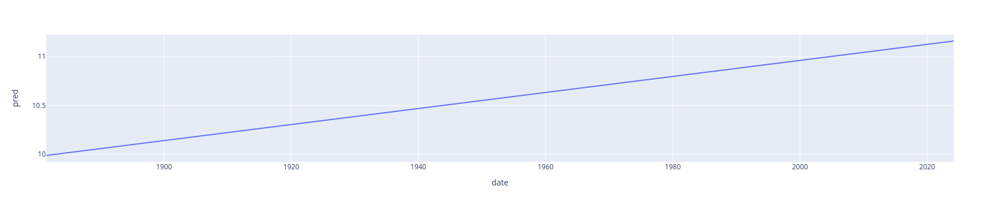

In [5]:
df2 = pd.DataFrame()
df2['date'] = pd.to_datetime(df['jul1'], unit='D', origin='julian')
df2['pred'] = results.predict(exog=sm.add_constant(df['jul1']))

px.line(df2,x='date', y='pred')

In [37]:
df2 = pd.pivot_table(df, values='max_smooth', index='year', columns=['dayofyear'], sort=True)

In [38]:
fig = px.imshow(df2, x=df2.columns, y=df2.index, text_auto=True, width=1000, height=600, aspect='auto', zmin=8, zmax=15)
fig = go.Figure(data=fig.data, layout=fig.layout)
fig.show()

TypeError: invalid Figure property: title
title
Bad property path:
title
^^^^^